In [1]:
from datetime import datetime, timezone
from operator import index

import requests
import sys

import pandas as pd
from future.backports.datetime import datetime
from pandas.api.types import is_numeric_dtype
import datetime; import logging; import os; import requests; import xgboost as xgb
from pathlib import Path
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from glob import glob

from metadata import locations
print(locations)

[{'name': 'Berlin', 'type': 'city', 'lat': 52.520007, 'lon': 13.404954, 'file': 'Berlin_52_520007_13_404954_66c71411bf8a6c0008d770ae.csv'}]


# Select Location to process

In [2]:
loc = locations[0]
loc

{'name': 'Berlin',
 'type': 'city',
 'lat': 52.520007,
 'lon': 13.404954,
 'file': 'Berlin_52_520007_13_404954_66c71411bf8a6c0008d770ae.csv'}

In [3]:
loc_name = loc['name']
df_weather = pd.read_csv(Path().absolute() / 'data_updates' / loc['file'])
# pd.to_datetime(df['mydates']).apply(lambda x: x.date())
df_weather

,dt,dt_iso,timezone,city_name,lat,lon,temp,visibility,dew_point,feels_like,...,wind_gust,rain_1h,rain_3h,snow_1h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,1230768000,2009-01-01 00:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-7.22,1800.0,-8.18,-12.79,...,NaN,NaN,NaN,NaN,NaN,75,701,Mist,mist,50n
1,1230771600,2009-01-01 01:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-6.60,2300.0,-6.60,-11.54,...,NaN,NaN,NaN,NaN,NaN,100,701,Mist,mist,50n
2,1230775200,2009-01-01 02:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-5.98,600.0,-6.33,-11.71,...,NaN,NaN,NaN,NaN,NaN,100,701,Mist,mist,50n
3,1230778800,2009-01-01 03:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-5.21,700.0,-5.57,-10.77,...,NaN,NaN,NaN,NaN,NaN,100,741,Fog,fog,50n
4,1230782400,2009-01-01 04:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-4.64,1500.0,-4.64,-9.18,...,NaN,NaN,NaN,NaN,NaN,75,701,Mist,mist,50n
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142546,1724266800,2024-08-21 19:00:00 +0000 UTC,7200,Berlin,52.520007,13.404954,18.08,10000.0,9.70,17.46,...,NaN,NaN,NaN,NaN,NaN,0,800,Clear,sky is clear,01n
142547,1724270400,2024-08-21 20:00:00 +0000 UTC,7200,Berlin,52.520007,13.404954,17.35,10000.0,9.52,16.71,...,6.71,NaN,NaN,NaN,NaN,0,800,Clear,sky is clear,01n
142548,1724274000,2024-08-21 21:00:00 +0000 UTC,7200,Berlin,52.520007,13.404954,16.83,10000.0,9.52,16.19,...,NaN,NaN,NaN,NaN,NaN,0,800,Clear,sky is clear,01n
142549,1724277600,2024-08-21 22:00:00 +0000 UTC,7200,Berlin,52.520007,13.404954,16.16,10000.0,10.04,15.58,...,NaN,NaN,NaN,NaN,NaN,0,800,Clear,sky is clear,01n


# Check updates to historical data
> WARNING specify which API to use for pooling historical data

In [4]:
# Check for updates
api=25

fpath = str(Path().absolute() / 'data_updates' / (loc_name +f'_*_api{api}.csv'))
files = glob(fpath)
for file in files:
    df_i = pd.read_csv(file)
    df_weather = pd.concat([df_weather, df_i], ignore_index=True)

In [5]:
df_weather

,dt,dt_iso,timezone,city_name,lat,lon,temp,visibility,dew_point,feels_like,...,wind_gust,rain_1h,rain_3h,snow_1h,snow_3h,clouds_all,weather_id,weather_main,weather_description,weather_icon
0,1230768000,2009-01-01 00:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-7.22,1800.0,-8.180000,-12.79,...,NaN,NaN,NaN,NaN,NaN,75,701,Mist,mist,50n
1,1230771600,2009-01-01 01:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-6.60,2300.0,-6.600000,-11.54,...,NaN,NaN,NaN,NaN,NaN,100,701,Mist,mist,50n
2,1230775200,2009-01-01 02:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-5.98,600.0,-6.330000,-11.71,...,NaN,NaN,NaN,NaN,NaN,100,701,Mist,mist,50n
3,1230778800,2009-01-01 03:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-5.21,700.0,-5.570000,-10.77,...,NaN,NaN,NaN,NaN,NaN,100,741,Fog,fog,50n
4,1230782400,2009-01-01 04:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,-4.64,1500.0,-4.640000,-9.18,...,NaN,NaN,NaN,NaN,NaN,75,701,Mist,mist,50n
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
142640,1724587200,2024-08-25 12:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,22.85,NaN,-21.269004,22.50,...,13.41,0.0,0.0,0.0,0.0,40,802,Clouds,scattered clouds,03d
142641,1724590800,2024-08-25 13:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,23.46,NaN,-26.843907,23.04,...,10.28,0.0,0.0,0.0,0.0,0,800,Clear,clear sky,01d
142642,1724594400,2024-08-25 14:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,23.75,NaN,-29.189025,23.30,...,12.07,0.0,0.0,0.0,0.0,0,800,Clear,clear sky,01d
142643,1724598000,2024-08-25 15:00:00 +0000 UTC,3600,Berlin,52.520007,13.404954,22.83,NaN,-24.871937,22.40,...,9.83,0.0,0.0,0.0,0.0,0,800,Clear,clear sky,01d


# PRELIMINARY CLEANING OF THE ORIGINAL DATASET 


In [6]:
# format time column and drop other time-related columns # TODO watchout for UTC/UTSC
df_weather['time'] = pd.to_datetime(df_weather['dt_iso'],format='%Y-%m-%d %H:%M:%S %z UTC')

# remove duplicates
df_weather.drop_duplicates(subset=['dt_iso','dt'], inplace=True)

# check rows
print(f"--- Duplicated_rows --- ")
print(df_weather.duplicated().sum())
print(f"--- Duplicated dt_iso --- ")
duplicate = df_weather[df_weather.duplicated('dt_iso')]
print(len(duplicate))
print(f"--- Duplicated dt --- ")
duplicate = df_weather[df_weather.duplicated('dt')]
print(len(duplicate))
print(f"--- Nans rows --- ")
df_weather.isnull().sum()/len(df_weather)

df_weather.drop(['dt','dt_iso','timezone'],inplace=True,axis=1)

# set time column as index 
df_weather.index = df_weather['time']

# Encode categoricals
labels = ['weather_id', 'weather_main','weather_description','weather_icon']
for col in labels:
    df_weather[col] = LabelEncoder().fit_transform(df_weather[col])#%%

# check df properties
def analyze_df(df : pd.DataFrame)->pd.DataFrame:
    res = pd.DataFrame({
        "is_unique": df.nunique() == len(df),
        "unique": df.nunique(),
        "with_nan":df.isna().any(),
        "percent_nan":round((df.isnull().sum()/len(df))*100,4),
        "dtype":df.dtypes
    })
    return res
analyze_df(df=df_weather)

--- Duplicated_rows --- 
0
--- Duplicated dt_iso --- 
0
--- Duplicated dt --- 
0
--- Nans rows --- 


,is_unique,unique,with_nan,percent_nan,dtype
city_name,False,1,False,0.0000,object
lat,False,1,False,0.0000,float64
lon,False,1,False,0.0000,float64
temp,False,4745,False,0.0000,float64
visibility,False,64,True,2.9750,float64
dew_point,False,3861,False,0.0000,float64
feels_like,False,5284,False,0.0000,float64
temp_min,False,4359,False,0.0000,float64
temp_max,False,4112,False,0.0000,float64
pressure,False,81,False,0.0000,int64


In [7]:
# Drop columns with numer of nans > threshold
threshold = 75.
cols = [c for c in df_weather if df_weather[c].isnull().sum()/len(df_weather)*100 > threshold]
print(f"Dropping {cols}")
df_weather.drop(cols, axis=1, inplace=True)
analyze_df(df=df_weather)

Dropping ['sea_level', 'grnd_level', 'wind_gust', 'rain_1h', 'rain_3h', 'snow_1h', 'snow_3h']


,is_unique,unique,with_nan,percent_nan,dtype
city_name,False,1,False,0.000,object
lat,False,1,False,0.000,float64
lon,False,1,False,0.000,float64
temp,False,4745,False,0.000,float64
visibility,False,64,True,2.975,float64
dew_point,False,3861,False,0.000,float64
feels_like,False,5284,False,0.000,float64
temp_min,False,4359,False,0.000,float64
temp_max,False,4112,False,0.000,float64
pressure,False,81,False,0.000,int64


In [8]:
# drop names that we clearly do not need from this dataframe
col_drop_name = ["city_name"]
df_weather.drop( col_drop_name,  axis='columns', inplace=True )

# Correlation analysis

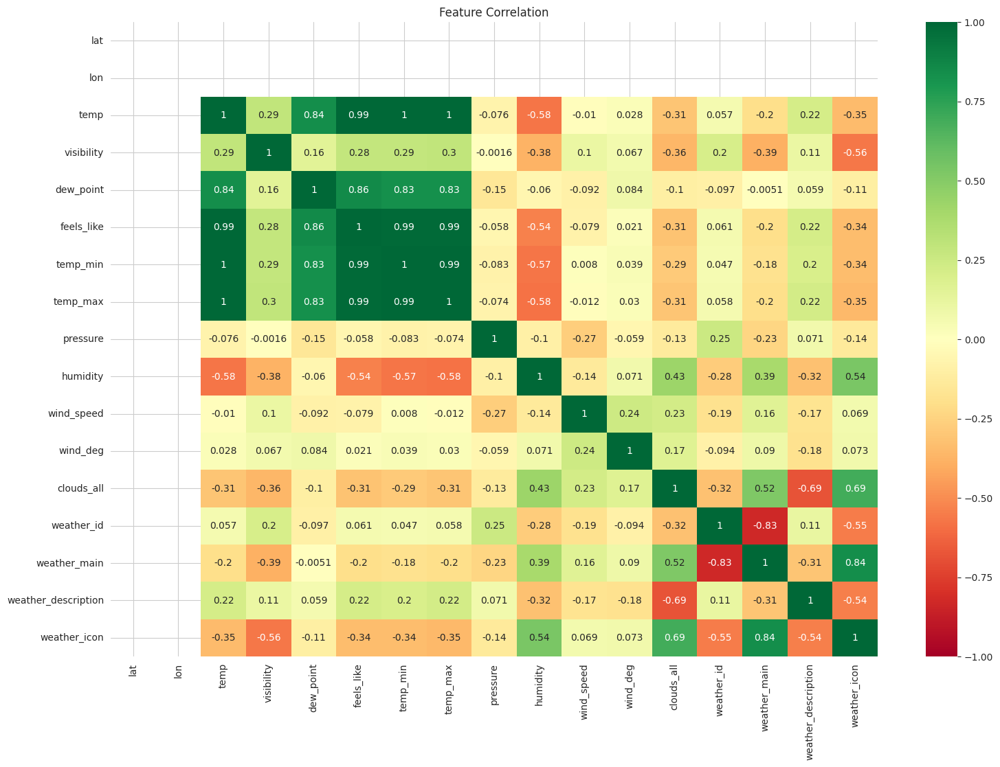

In [9]:
def feat_corr(input_df):
    corr = input_df.corr()
    plt.figure(figsize=(18,12))
    #plot heat map
    g=sns.heatmap(corr,annot=True,cmap="RdYlGn", vmin=-1, vmax=1)
    plt.title('Feature Correlation')

    return plt.show()
feat_corr(df_weather.select_dtypes(include=[float,int]))

In [10]:
def print_highly_correlated(df, features, threshold=0.7):
    """Prints highly correlated features pairs in the data frame (helpful for feature engineering)"""
    corr_df = df[features].corr() # get correlations
    correlated_features = np.where(np.abs(corr_df) > threshold) # select ones above the abs threshold
    correlated_features = [(corr_df.iloc[x,y], x, y) for x, y in zip(*correlated_features) if x != y and x < y] # avoid duplication
    s_corr_list = sorted(correlated_features, key=lambda x: -abs(x[0])) # sort by correlation value

    if s_corr_list == []:
        print("There are no highly correlated features with correlation above", threshold)
    else:
        for v, i, j in s_corr_list:
            cols = df[features].columns
            print ("%s and %s = %.3f" % (corr_df.index[i], corr_df.columns[j], v))
print_highly_correlated(df=df_weather,features=df_weather.keys())

temp and temp_max = 0.998
temp and temp_min = 0.996
temp_min and temp_max = 0.994
temp and feels_like = 0.993
feels_like and temp_max = 0.992
feels_like and temp_min = 0.988
dew_point and feels_like = 0.856
weather_main and weather_icon = 0.838
temp and dew_point = 0.836
dew_point and temp_max = 0.833
weather_id and weather_main = -0.833
dew_point and temp_min = 0.832


Apparantly there is strong correlation between the features that we talked about. Having strong correlation between features might cuase multicolinearity. So, we can drop 'weather_icon', 'weather_main', 'weather_description', and 'weather_id' and just keep 'clouds_all'. There is also a very strong correlation between 'temp', 'temp_min' and 'temp_max'. So we drop temp_max and temp_min and just keep 'temp'.

In [11]:
col_drop_name = [
    'weather_id', 'weather_main','weather_description','weather_icon', 
    'temp_min', 'temp_max', 'dew_point', 'feels_like'
]
df_weather.drop(col_drop_name, axis = 1 , inplace = True)
print_highly_correlated(df=df_weather,features=df_weather.keys())
df_weather

There are no highly correlated features with correlation above 0.7


,lat,lon,temp,visibility,pressure,humidity,wind_speed,wind_deg,clouds_all,time
time,,,,,,,,,,
2009-01-01 00:00:00+00:00,52.520007,13.404954,-7.22,1800.0,1023,92,3.60,240,75,2009-01-01 00:00:00+00:00
2009-01-01 01:00:00+00:00,52.520007,13.404954,-6.60,2300.0,1024,100,3.10,240,100,2009-01-01 01:00:00+00:00
2009-01-01 02:00:00+00:00,52.520007,13.404954,-5.98,600.0,1024,97,4.10,260,100,2009-01-01 02:00:00+00:00
2009-01-01 03:00:00+00:00,52.520007,13.404954,-5.21,700.0,1024,97,4.10,260,100,2009-01-01 03:00:00+00:00
2009-01-01 04:00:00+00:00,52.520007,13.404954,-4.64,1500.0,1024,100,3.10,250,75,2009-01-01 04:00:00+00:00
...,...,...,...,...,...,...,...,...,...,...
2024-08-25 12:00:00+00:00,52.520007,13.404954,22.85,NaN,1019,50,8.05,269,40,2024-08-25 12:00:00+00:00
2024-08-25 13:00:00+00:00,52.520007,13.404954,23.46,NaN,1019,45,7.15,278,0,2024-08-25 13:00:00+00:00
2024-08-25 14:00:00+00:00,52.520007,13.404954,23.75,NaN,1019,43,6.71,300,0,2024-08-25 14:00:00+00:00


In [12]:
# Checking Nans and duplicates in each columns
def check_Nans_Dups(df_input):
    # print('Number of Nans in each column; Uniqe :')
    for name, col in df_input.items():
        print(f"{name} \t IsNan={col.isna().any()}   %Nan={round((col.isnull().sum()/len(col))*100,4)}   Unique={col.nunique()}   Ndups={col.duplicated().sum()}")
    # print(f'Number of duplicates in the dataframe : {df_input.duplicated().sum()}')
    return
check_Nans_Dups(df_weather)
print(f"Cols with Nans: {df_weather.columns[df_weather.isna().any()].tolist()}")

lat 	 IsNan=False   %Nan=0.0   Unique=1   Ndups=137176
lon 	 IsNan=False   %Nan=0.0   Unique=1   Ndups=137176
temp 	 IsNan=False   %Nan=0.0   Unique=4745   Ndups=132432
visibility 	 IsNan=True   %Nan=2.975   Unique=64   Ndups=137112
pressure 	 IsNan=False   %Nan=0.0   Unique=81   Ndups=137096
humidity 	 IsNan=False   %Nan=0.0   Unique=90   Ndups=137087
wind_speed 	 IsNan=False   %Nan=0.0   Unique=617   Ndups=136560
wind_deg 	 IsNan=False   %Nan=0.0   Unique=361   Ndups=136816
clouds_all 	 IsNan=False   %Nan=0.0   Unique=101   Ndups=137076
time 	 IsNan=False   %Nan=0.0   Unique=137177   Ndups=0
Cols with Nans: ['visibility']


In [13]:
# Treat nans
df_weather['visibility']=df_weather['visibility'].interpolate(method='linear', limit_direction='forward')
# df_weather['visibility'].fillna(df_weather['visibility'].mean(), inplace=True)
# df_weather['rain_1h'] = df_weather['rain_1h'].fillna(0.)


In [14]:
df_weather.describe().round(2)

,lat,lon,temp,visibility,pressure,humidity,wind_speed,wind_deg,clouds_all
count,137177.00,137177.0,137177.00,137177.00,137177.00,137177.00,137177.00,137177.00,137177.00
mean,52.52,13.4,10.94,9386.78,1015.39,73.02,4.33,189.15,36.23
std,0.00,0.0,8.32,1772.34,9.15,17.93,2.29,95.83,37.40
min,52.52,13.4,-21.78,75.00,966.00,11.00,0.00,0.00,0.00
25%,52.52,13.4,4.84,9999.00,1010.00,61.00,2.60,107.00,0.00
50%,52.52,13.4,10.66,10000.00,1016.00,77.00,4.10,210.00,20.00
75%,52.52,13.4,17.02,10000.00,1021.00,87.00,5.70,270.00,75.00
max,52.52,13.4,37.85,10000.00,1047.00,100.00,24.14,360.00,100.00


- Maximum pressure on earth is recorded as 1080hPa : https://wmo.asu.edu/content/world-highest-sea-level-air-pressure-below-700m
- Minimum pressure on earth is recorded as 870hPa : https://wmo.asu.edu/content/world-lowest-sea-level-air-pressure-excluding-tornadoes
- Maximum wind speed on earth is recorded as 113 m/s : https://www.wunderground.com/cat6/the-highest-anemometer-measured-wind-speeds-on-earth
- So we set the max threshold as these numbers and replace the outliers with Nan values and then use interpolation to fill the gap.

In [15]:
# Sanity check
physical_limits = dict(
    temp=(-60.,60.), # degrees, Celsius
    visibility=(0., 1e4), # distance, meters
    pressure=(870.,1080.), # pressure hPa, 
    humidity=(0.,100), # humidity, percent
    wind_speed=(0.,113), # velocity, m/s
    wind_deg=(0.,360), # degree, deg.
    clouds_all=(0., 100.) # percent? 
)
# if not physical, remove and interpolate
for key, lim in physical_limits.items():
    df_weather[key].where(df_weather[key] < lim[0], np.nan)
    df_weather[key].where(df_weather[key] > lim[1], np.nan)
df_weather=df_weather.interpolate(method='linear', limit_direction='forward')

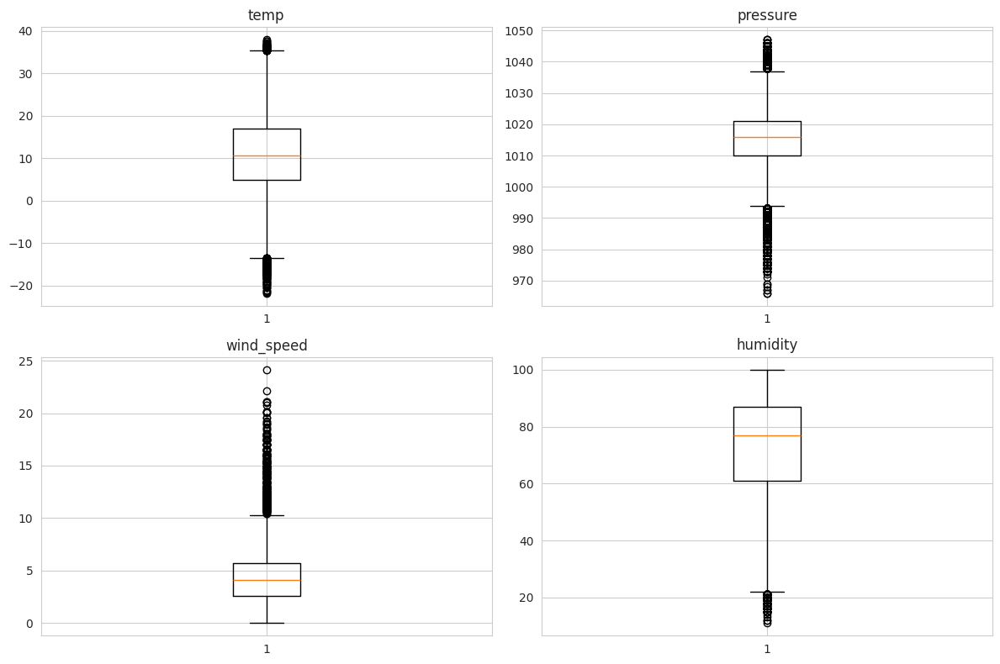

In [17]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(12,8))
columns_to_plot=['temp','pressure', 'wind_speed', 'humidity']
# loop through the subplots and plot each column
for i, ax in enumerate(axes.flat):
    if i < len(columns_to_plot):
        ax.boxplot(x = df_weather[columns_to_plot[i]])
        ax.set_title(columns_to_plot[i])
    else:
        ax.set_visible(False)

plt.tight_layout()  # adjust the spacing between subplots
plt.show() 

# Visualize Time Series

In [18]:
def plot_series(df=None, column=None, series=pd.Series([]),
                label=None, ylabel=None, title=None, start=0, end=None):
    """
    Plots a certain time-series which has either been loaded in a dataframe
    and which constitutes one of its columns or it a custom pandas series 
    created by the user. The user can define either the 'df' and the 'column' 
    or the 'series' and additionally, can also define the 'label', the 
    'ylabel', the 'title', the 'start' and the 'end' of the plot.
    """
    sns.set()
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.set_xlabel('Time', fontsize=16)
    if column:
        ax.plot(df[column][start:end], label=label)
        ax.set_ylabel(ylabel, fontsize=16)
    if series.any():
        ax.plot(series, label=label)
        ax.set_ylabel(ylabel, fontsize=16)
    if label:
        ax.legend(fontsize=16)
    if title:
        ax.set_title(title, fontsize=24)
    ax.grid(True)
    return ax

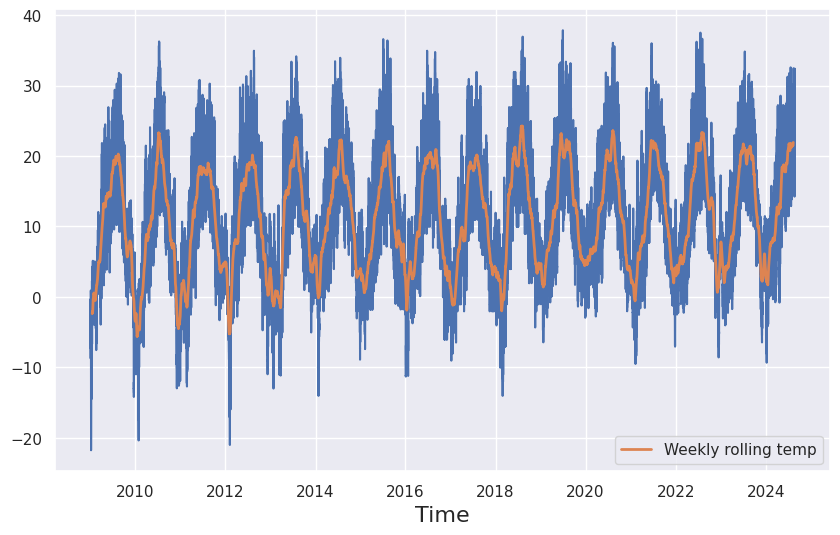

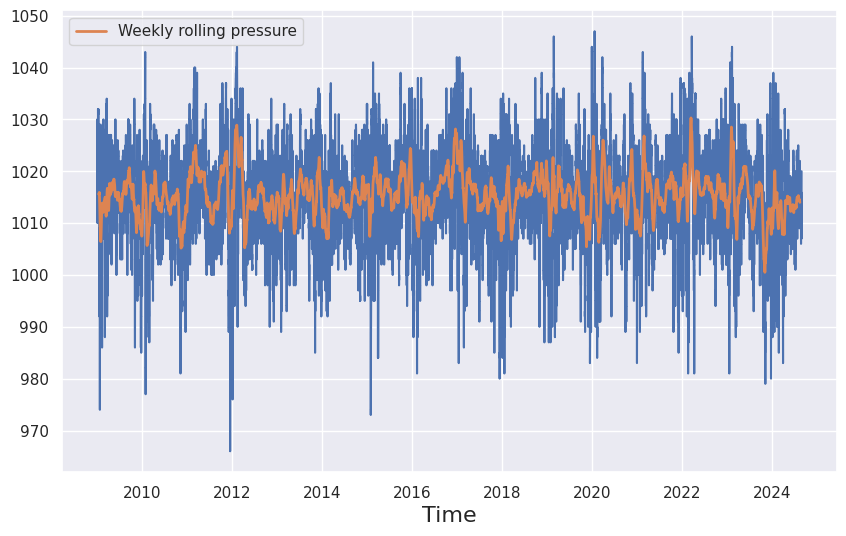

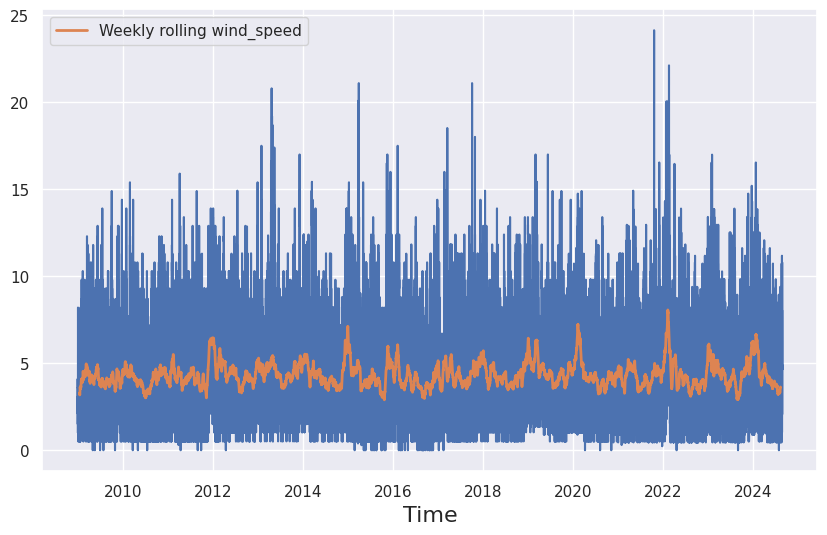

In [19]:
for key in ['temp','pressure','wind_speed']:
    ax = plot_series(df_weather,key)
    rolling = df_weather[key].rolling(window=4*24*7, center=True).mean()
    ax.plot(rolling, linestyle='-', linewidth=2, label=f'Weekly rolling {key}')
    ax.legend()
plt.show()

# Save cleaned dataframe 


In [22]:
# Save dataframe
df_weather.to_csv(Path().absolute() / 'data_preprocessed' / (loc_name+f'_api{api}_n{len(files)}.csv'), index=False)

In [21]:
import plotly.io as pio
pio.renderers.default = 'notebook'
import plotly.offline as pyo
import plotly.graph_objects as go
pyo.init_notebook_mode(connected=True)

In [23]:
df_tmp = df_weather.copy(deep=True)
df_tmp['temp'+'_ma'] = df_tmp['temp'].rolling(window=7, center=True).mean()

fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_tmp.index, # Variable in the x-axis
    y=df_tmp['temp'], # Variable in the y-axis
    mode='markers', # This explicitly states that we want our observations to be represented by points
    name='temp',
))
# fig.add_trace(go.Scatter(
#     x=df_window_plot.index, # Variable in the x-axis
#     y=df_window_plot['Forecasted Load'], # Variable in the y-axis
#     mode='markers', # This explicitly states that we want our observations to be represented by points
#     name='Forecasted Load',
# ))
fig.add_trace(go.Line(
    x=df_tmp.index, # Variable in the x-axis
    y=df_tmp['temp_ma'], # Variable in the y-axis
    # mode='markers', # This explicitly states that we want our observations to be represented by points
    name='MA',
))
fig.show()

/home/vsevolod/.local/lib/python3.10/site-packages/plotly/graph_objs/_deprecations.py:378: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.


